# Importing all the required libraries

In [1]:
import os
import re
import sys
import nltk
from nltk.corpus import stopwords
from nltk.stem import PorterStemmer
from nltk.stem import WordNetLemmatizer
from nltk.tokenize import word_tokenize

In [2]:
import itertools
import numpy as np 
import pandas as pd 
import seaborn as sns
from joblib import dump, load
from wordcloud import WordCloud
import matplotlib.pyplot as plt

In [3]:
from sklearn.preprocessing import LabelEncoder
from keras.utils.np_utils import to_categorical
from sklearn.model_selection import train_test_split
from sklearn.feature_extraction.text import CountVectorizer
from sklearn.metrics import accuracy_score, precision_score, recall_score, f1_score
from sklearn.metrics import confusion_matrix
from sklearn.neighbors import KNeighborsClassifier

# Reading the Dataset

In [4]:
df = pd.read_csv('ResumeDataSet.csv')
print(df[0:3])
print('.')
print('.')
print('.')
df.info()


       Category                                             Resume
0  Data Science  Skills * Programming Languages: Python (pandas...
1  Data Science  Education Details \r\nMay 2013 to May 2017 B.E...
2  Data Science  Areas of Interest Deep Learning, Control Syste...
.
.
.
<class 'pandas.core.frame.DataFrame'>
RangeIndex: 962 entries, 0 to 961
Data columns (total 2 columns):
 #   Column    Non-Null Count  Dtype 
---  ------    --------------  ----- 
 0   Category  962 non-null    object
 1   Resume    962 non-null    object
dtypes: object(2)
memory usage: 15.2+ KB


# List of all Categories

In [5]:
for i in range(len(df['Category'].unique())):
    print(df['Category'].unique()[i])

Data Science
HR
Advocate
Arts
Web Designing
Mechanical Engineer
Sales
Health and fitness
Civil Engineer
Java Developer
Business Analyst
SAP Developer
Automation Testing
Electrical Engineering
Operations Manager
Python Developer
DevOps Engineer
Network Security Engineer
PMO
Database
Hadoop
ETL Developer
DotNet Developer
Blockchain
Testing


# Value count of each category in the dataset

In [6]:
print(df['Category'].value_counts())

Java Developer               84
Testing                      70
DevOps Engineer              55
Python Developer             48
Web Designing                45
HR                           44
Hadoop                       42
Blockchain                   40
ETL Developer                40
Operations Manager           40
Data Science                 40
Sales                        40
Mechanical Engineer          40
Arts                         36
Database                     33
Electrical Engineering       30
Health and fitness           30
PMO                          30
Business Analyst             28
DotNet Developer             28
Automation Testing           26
Network Security Engineer    25
SAP Developer                24
Civil Engineer               24
Advocate                     20
Name: Category, dtype: int64


# Visualizing the data distribution in each category.

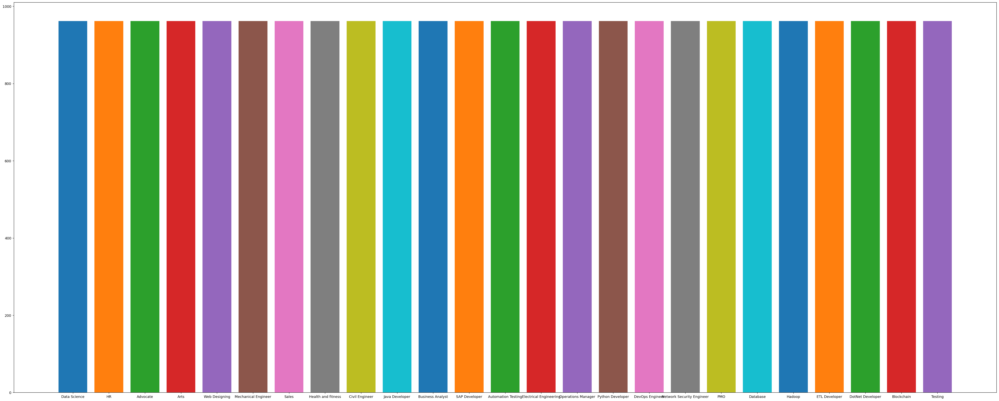

In [7]:
plt.figure(figsize=(50, 20), dpi=130)
for i in range(len(df['Category'].unique())):
    plt.bar(df['Category'].unique()[i], len(df['Category']==df['Category'].unique()[i]))
plt.show()

# Visualizing most commonly used words in each type of Resumes

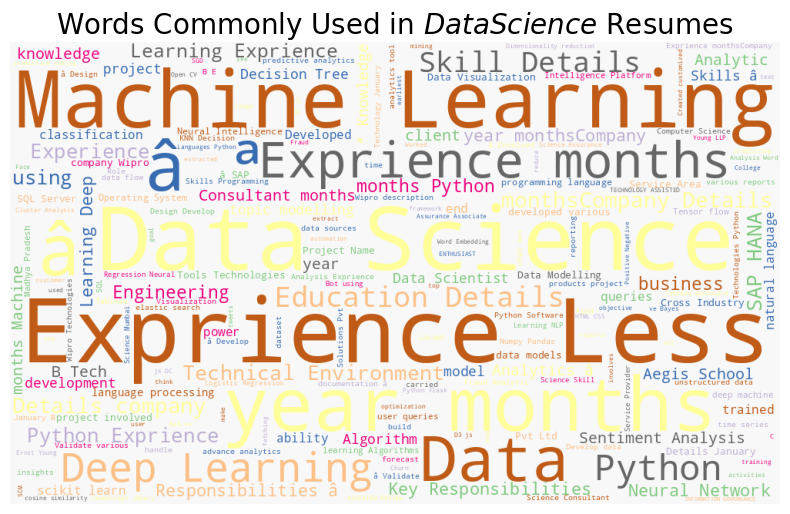

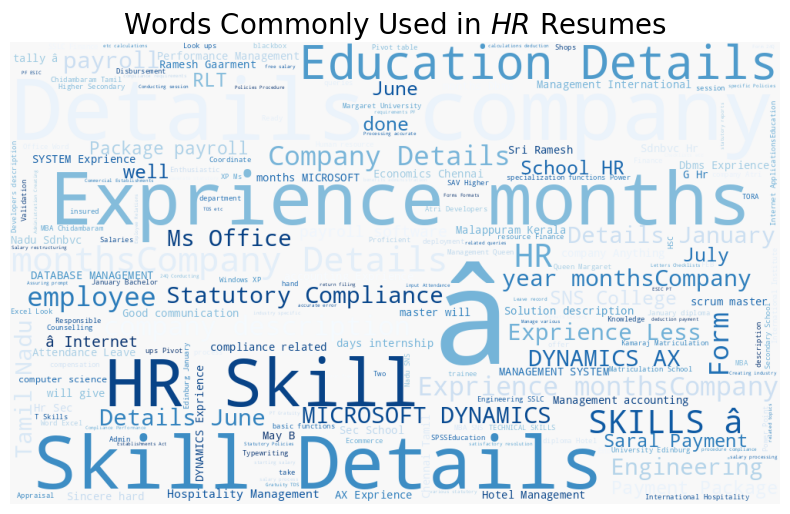

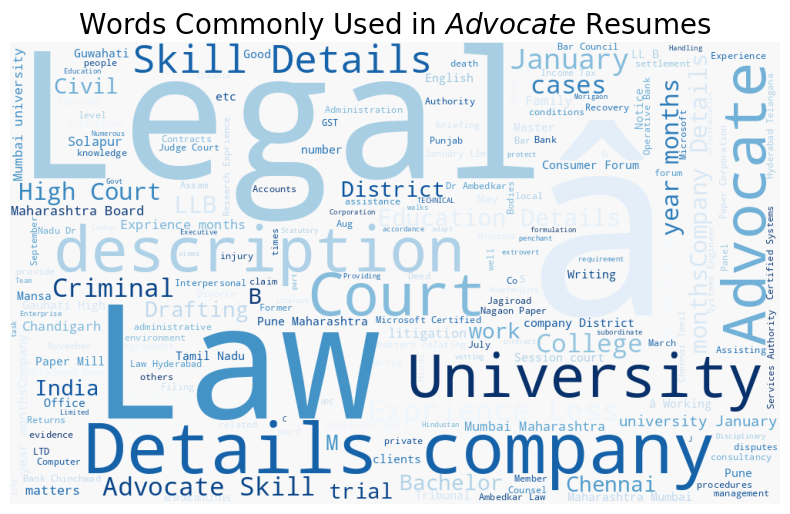

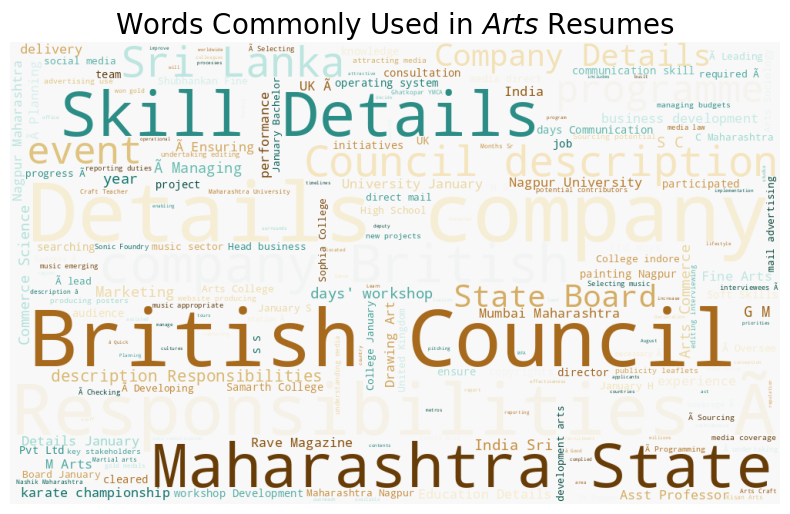

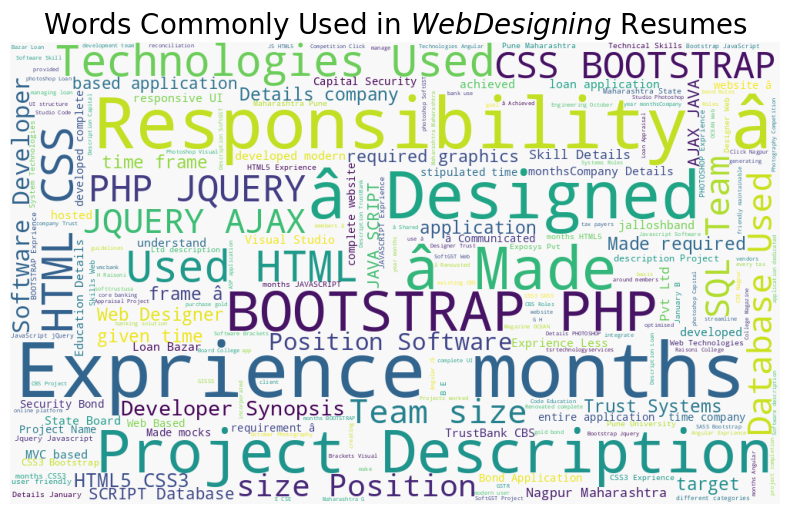

...

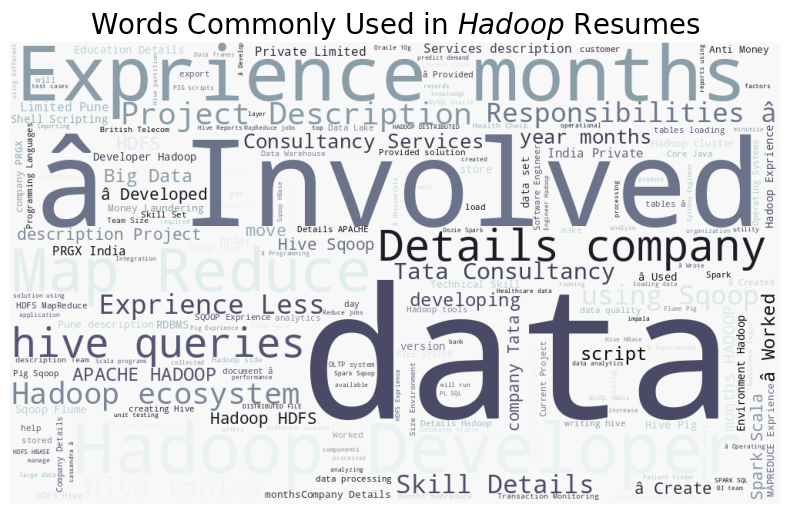

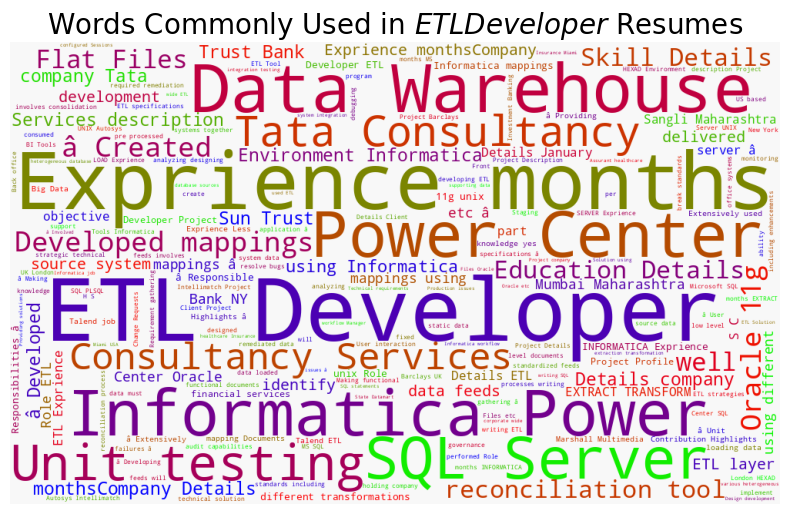

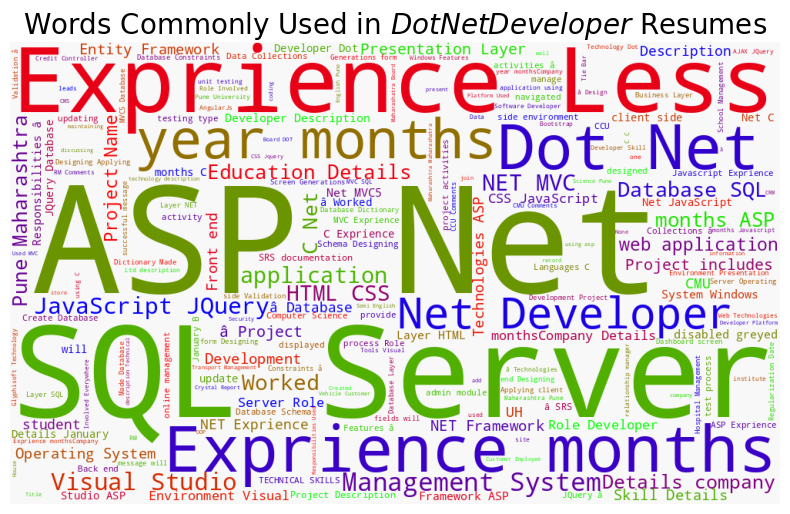

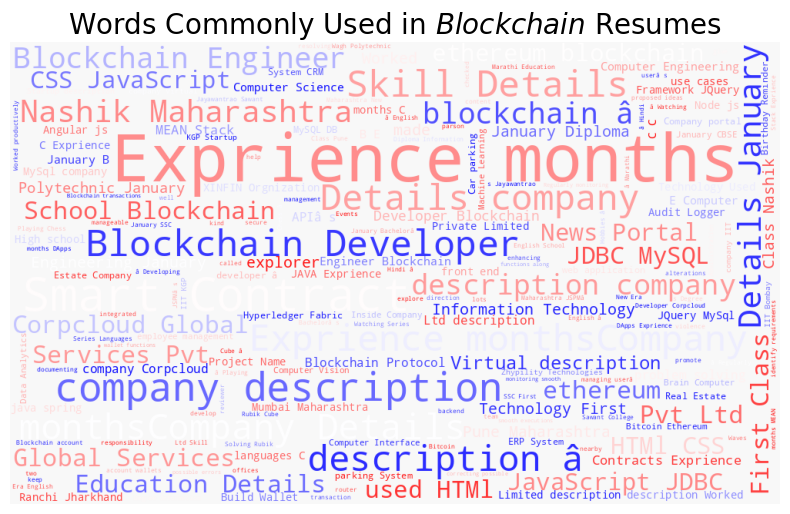

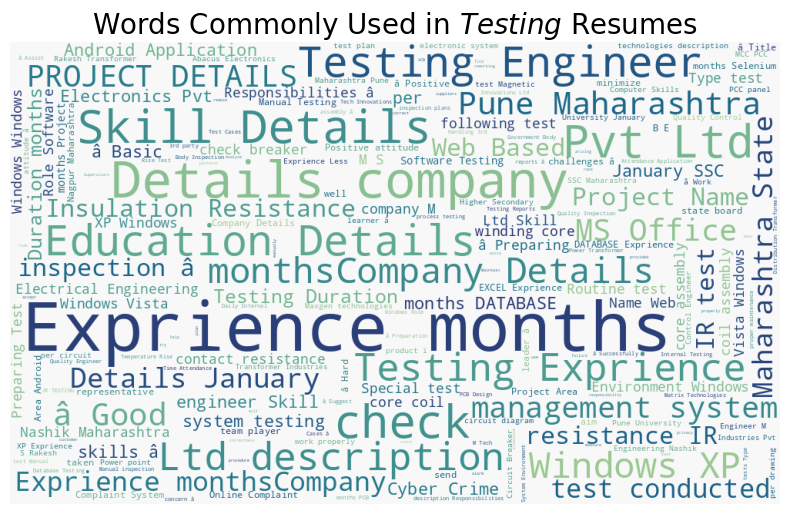

In [8]:
a=[ 'Accent_r', 'Blues', 'Blues_r', 'BrBG', 'viridis', 'viridis_r', 'vlag', 'vlag_r', 'winter', 'winter_r','BrBG_r', 'BuGn', 'BuGn_r', 'afmhot', 'afmhot_r', 'autumn', 'autumn_r', 'binary', 'binary_r', 'bone', 'bone_r', 'brg', 'brg_r', 'bwr', 'crest_r']
for label, cmap in zip(df['Category'].unique(), a):
    text = df.query("Category == @label")["Resume"].str.cat(sep=" ")
    plt.figure(figsize=(10, 6))
    wc = WordCloud(width=1000, height=600, background_color="#f8f8f8", colormap=cmap)
    wc.generate_from_text(text)
    plt.imshow(wc)
    plt.axis("off")
    plt.title(f"Words Commonly Used in ${label}$ Resumes", size=20)
    plt.show()

# Visualizing the length distribution of the content in the Resumes.

<ipython-input-9-4cde9b11b65b>:3: UserWarning: 

`distplot` is a deprecated function and will be removed in seaborn v0.14.0.

Please adapt your code to use either `displot` (a figure-level function with
similar flexibility) or `histplot` (an axes-level function for histograms).

For a guide to updating your code to use the new functions, please see
https://gist.github.com/mwaskom/de44147ed2974457ad6372750bbe5751

  sns.distplot(df['length']).set_title('Resume length distribution')


Text(0.5, 1.0, 'Resume length distribution')

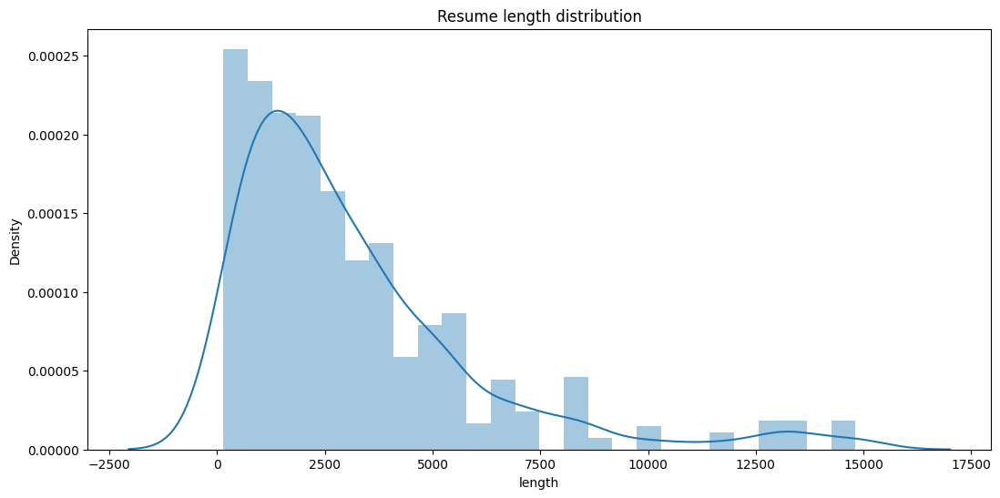

In [9]:
df['length'] = df['Resume'].str.len()
plt.figure(figsize=(12.8,6))
sns.distplot(df['length']).set_title('Resume length distribution')

# Summary of Length Distribution

In [10]:
df['length'].describe()

count      962.000000
mean      3160.364865
std       2886.528521
min        142.000000
25%       1217.250000
50%       2355.000000
75%       4073.750000
max      14816.000000
Name: length, dtype: float64

# Visualizing of number of words in each category of resume using boxplot

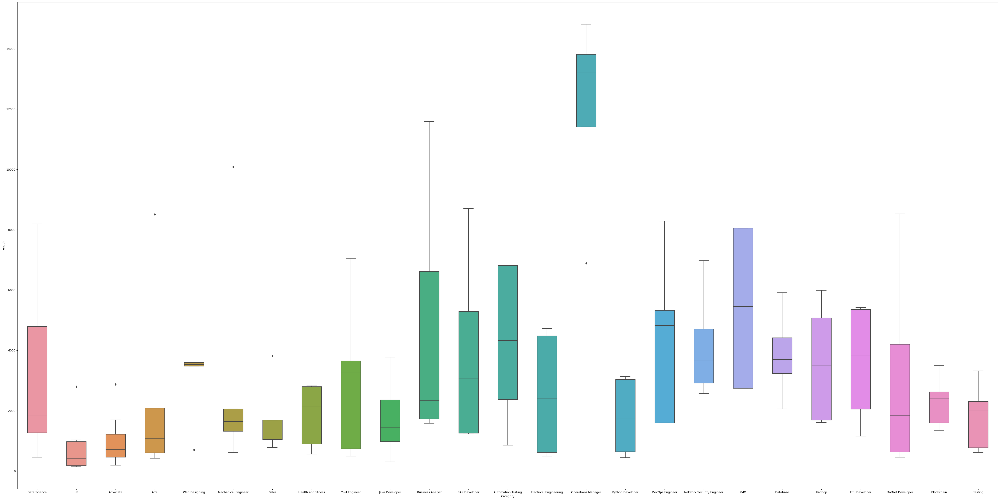

In [11]:
plt.figure(figsize=(60,30))
sns.boxplot(data=df, x='Category', y='length', width=.5);

# Pre-processing steps

# Checking for missing data

In [12]:
print(df.isnull().sum())

Category    0
Resume      0
length      0
dtype: int64


# Converting the data into lower case and removing words with small lengths

In [13]:
df['Resume'] = df['Resume'].apply(lambda x:x.lower())
for i in range(len(df)):
    lw=[]
    for j in df['Resume'][i].split():
        if len(j)>=3:                  
            lw.append(j)
    df['Resume'][i]=" ".join(lw)

<ipython-input-13-79d6dd5744c6>:7: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df['Resume'][i]=" ".join(lw)


# Removing punctuations

In [14]:
ps = list(";?.:!,")
df['Resume'] = df['Resume']

for p in ps:   
    df['Resume'] = df['Resume'].str.replace(p, '')

<ipython-input-14-34aee2d96334>:5: FutureWarning: The default value of regex will change from True to False in a future version. In addition, single character regular expressions will *not* be treated as literal strings when regex=True.
  df['Resume'] = df['Resume'].str.replace(p, '')


# Removing '\n' and '\t', extra spaces, quoting text and progressive pronouns

In [15]:

df['Resume'] = df['Resume'].str.replace("    ", " ")
df['Resume'] = df['Resume'].str.replace('"', '')
df['Resume'] = df['Resume'].apply(lambda x: x.replace('\t', ' '))
df['Resume'] = df['Resume'].str.replace("'s", "")
df['Resume'] = df['Resume'].apply(lambda x: x.replace('\n', ' '))


# Applying Lemmatization

In [16]:
nltk.download('punkt')
nltk.download('wordnet')
nltk.download('omw-1.4')

[nltk_data] Downloading package punkt to /root/nltk_data...
[nltk_data]   Unzipping tokenizers/punkt.zip.
[nltk_data] Downloading package wordnet to /root/nltk_data...
[nltk_data] Downloading package omw-1.4 to /root/nltk_data...


True

In [17]:
wl = WordNetLemmatizer()
nr = len(df)
lis = []
for r in range(0, nr):
    ll = []
    t = df.loc[r]['Resume']
    tw = str(t).split(" ")
    for w in tw:
        ll.append(wl.lemmatize(w, pos="v"))
    lt = " ".join(ll)
    lis.append(lt)

In [18]:
df['Resume'] = lis

# Removing Stop-words

In [19]:
nltk.download('stopwords')

[nltk_data] Downloading package stopwords to /root/nltk_data...
[nltk_data]   Unzipping corpora/stopwords.zip.


True

In [20]:
sw = list(stopwords.words('english'))
for s in sw:
    rs = r"\b" + s + r"\b"
    df['Resume'] = df['Resume'].str.replace(rs, '')

<ipython-input-20-b2a2537f2ca1>:4: FutureWarning: The default value of regex will change from True to False in a future version.
  df['Resume'] = df['Resume'].str.replace(rs, '')


# Tokenization

In [21]:
def tokenizetext(text):
  tokens = word_tokenize(text)
  return ' '.join(tokens)

df['Resume'] = df['Resume'].apply(tokenizetext)

# Visualizing most commonly used words in Resumes after applying NLP techniques 

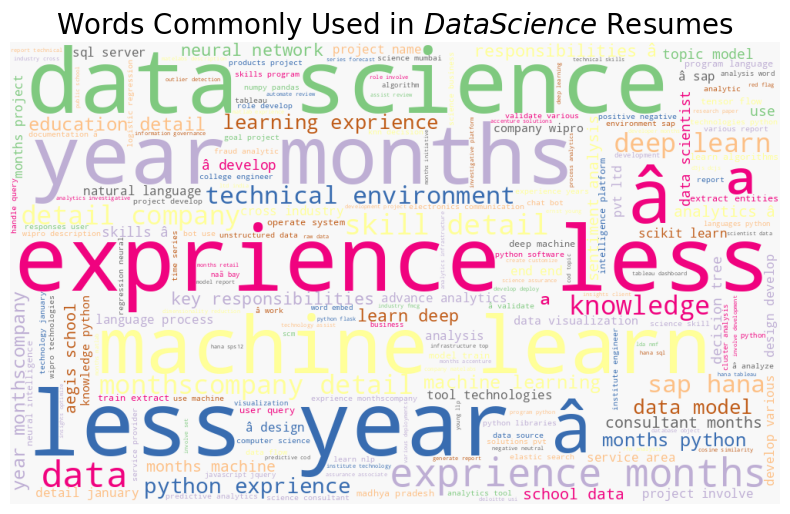

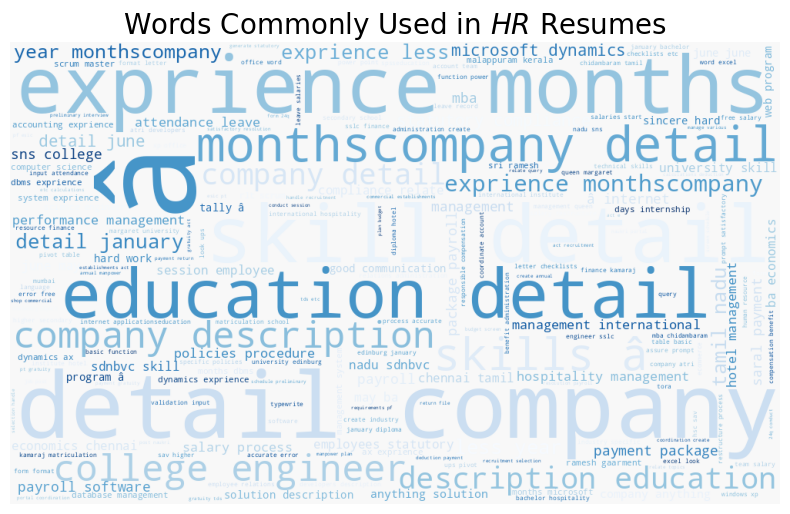

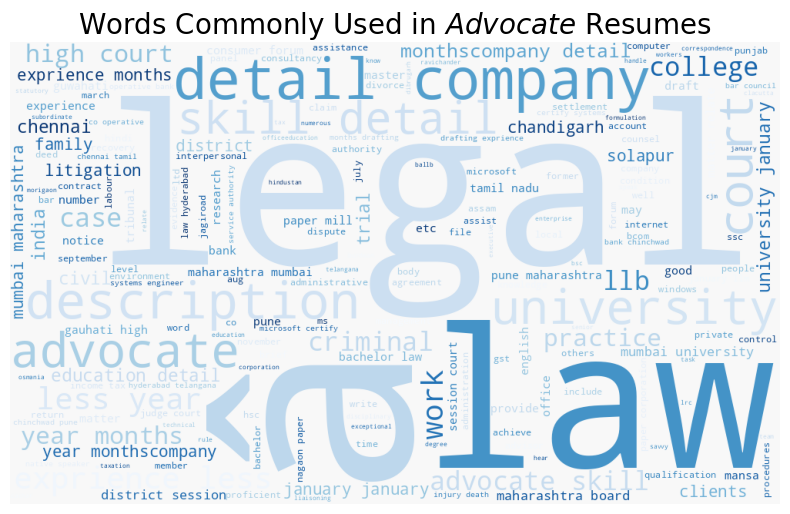

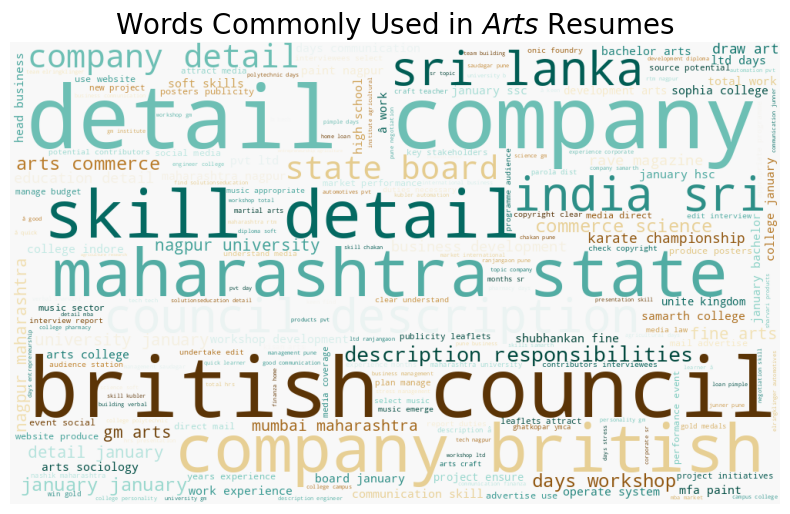

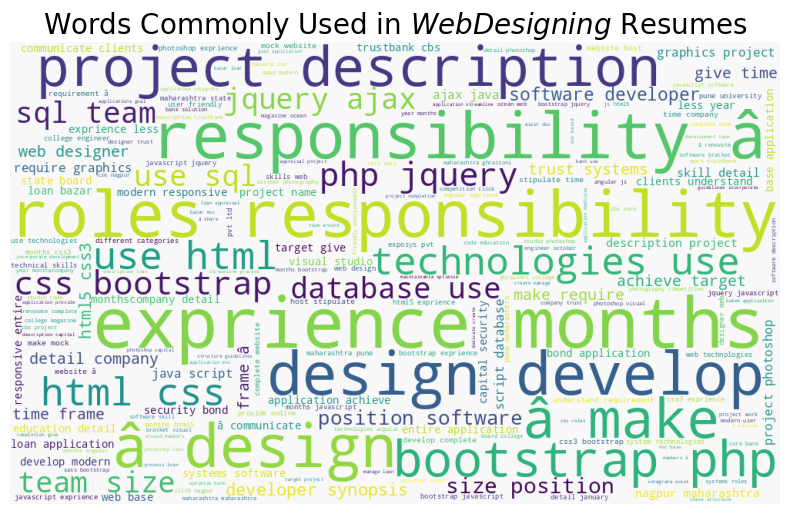

...

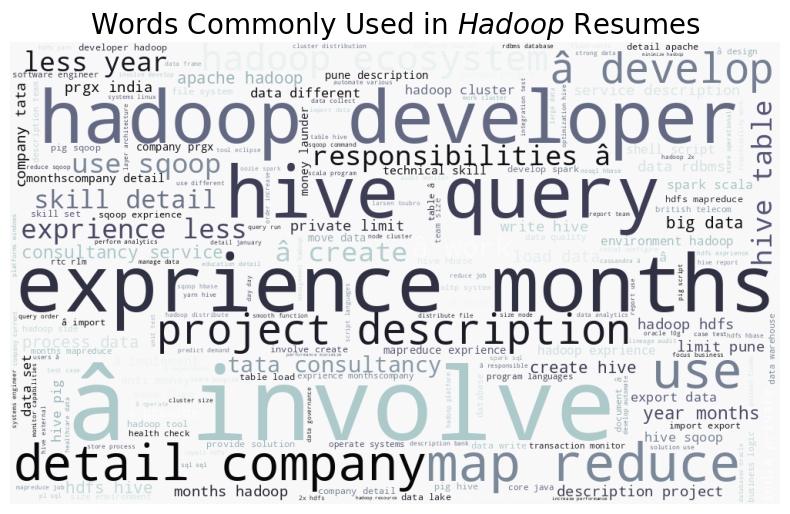

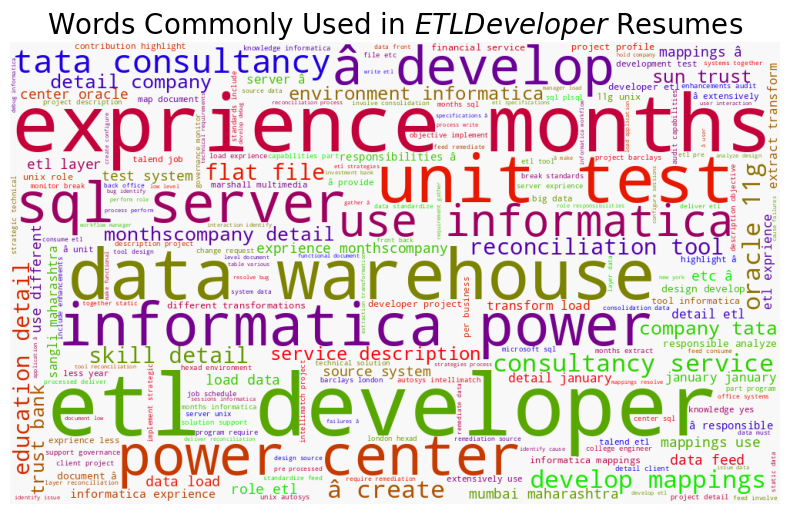

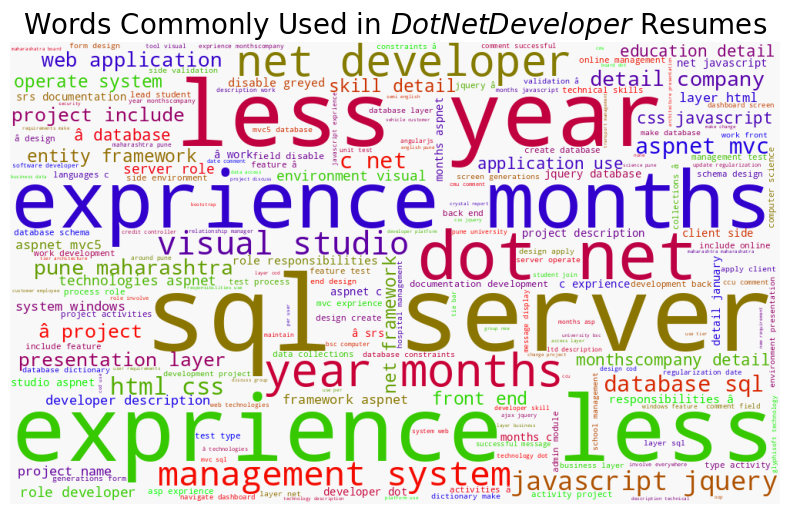

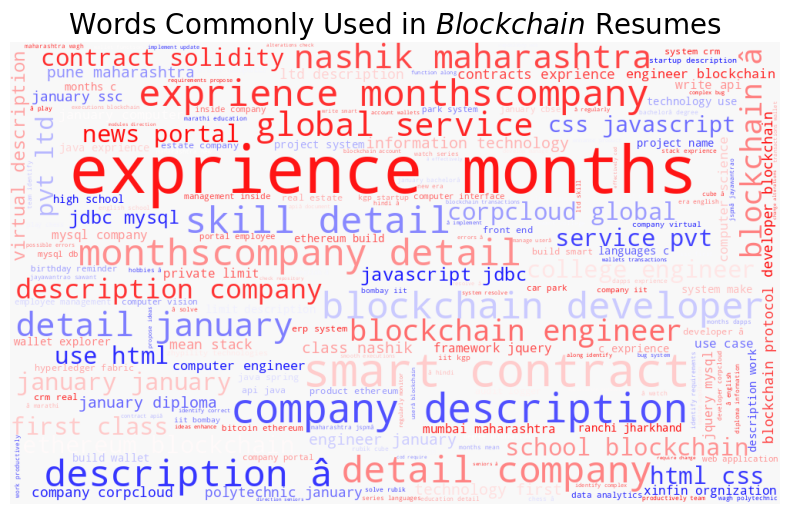

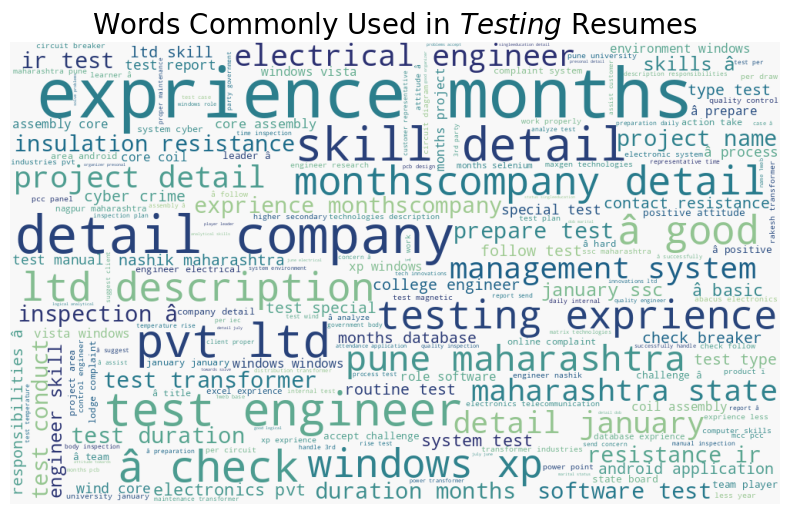

In [22]:
a=[ 'Accent_r', 'Blues', 'Blues_r', 'BrBG', 'viridis', 'viridis_r', 'vlag', 'vlag_r', 'winter', 'winter_r','BrBG_r', 'BuGn', 'BuGn_r', 'afmhot', 'afmhot_r', 'autumn', 'autumn_r', 'binary', 'binary_r', 'bone', 'bone_r', 'brg', 'brg_r', 'bwr', 'crest_r']
for label, cmap in zip(df['Category'].unique(), a):
    text = df.query("Category == @label")["Resume"].str.cat(sep=" ")
    plt.figure(figsize=(10, 6))
    wc = WordCloud(width=1000, height=600, background_color="#f8f8f8", colormap=cmap)
    wc.generate_from_text(text)
    plt.imshow(wc)
    plt.axis("off")
    plt.title(f"Words Commonly Used in ${label}$ Resumes", size=20)
    plt.show()

# Data Preparation for Training and Testing

# Encoding Labels

In [23]:
le = LabelEncoder()
df['Category'] = le.fit_transform(df['Category'])

# Using Bag of Words approach for converting the content in resumes into vector form

In [24]:
cv = CountVectorizer(max_features = 2500)
X = cv.fit_transform(df['Resume']).toarray()
y = df['Category']

# Splitting the Data using Stratified split

In [25]:
X_train, X_test, y_train, y_test = train_test_split(X, y, test_size = 0.1, stratify=y, random_state = 42)

In [26]:
def plot_confusion_matrix(cm, classes,
                          normalize=False,
                          title='Confusion matrix',
                              cmap=plt.cm.Greens):
    plt.figure(figsize=(50, 20), dpi=130)
    plt.imshow(cm, interpolation='nearest', cmap=cmap)
    plt.title(title)
    plt.colorbar()
    tick_marks = np.arange(len(classes))
    plt.xticks(tick_marks, classes, rotation=45)
    plt.yticks(tick_marks, classes)

    if normalize:
        cm = cm.astype('float') / cm.sum(axis=1)[:, np.newaxis]

    thresh = cm.max() / 2.
    for i, j in itertools.product(range(cm.shape[0]), range(cm.shape[1])):
        plt.text(j, i, cm[i, j],
                 horizontalalignment="center",
                 color="white" if cm[i, j] > thresh else "black")

    plt.tight_layout()
    plt.ylabel('True label')
    plt.xlabel('Predicted label')


# Using KNeighbors Classifier as the Model and printing evaluating it using confusion matrix

In [36]:
clf = KNeighborsClassifier(n_neighbors=7)
clf = clf.fit(X_train, y_train)
yp = clf.predict(X_test)

Accuracy: 0.9072164948453608
Precision: 0.9373424971363116
Recall: 0.9072164948453608
F1 score: 0.9072164948453608


['knei.joblib']

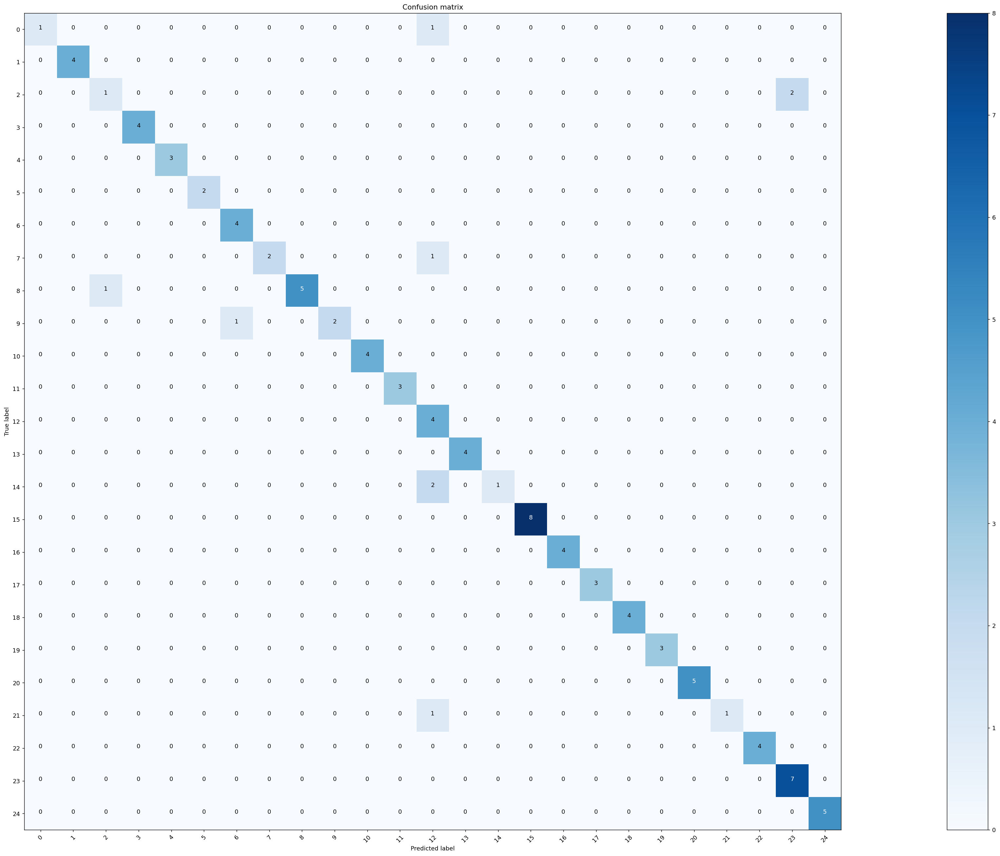

In [49]:
from sklearn import metrics
print('Accuracy:', metrics.accuracy_score(y_test, yp))
print('Precision:', metrics.precision_score(y_test, yp, average='weighted'))
print('Recall:', metrics.recall_score(y_test, yp, average='weighted'))
print('F1 score:', metrics.f1_score(y_test, yp, average='micro'))


CM = confusion_matrix(y_test, yp)
plot_confusion_matrix(CM, classes = range(25),cmap=plt.cm.Blues)
dump(clf, 'knei.joblib') 